# NFL Team Data Analysis
## Nick Cantalupa
### This data was scraped from www.pro-football-reference.com using Python's BeautifulSoup and Selenium Webdriver. The dataset contains stats for 672 teams across 21 seasons.

In [3]:
import pandas as pd

with open("team_stats_2003_2023.csv", 'r') as infile:
    df = pd.read_csv(infile)

df.head()

,year,team,wins,losses,win_loss_perc,points,points_opp,points_diff,mov,g,...,rush_td,rush_yds_per_att,rush_fd,penalties,penalties_yds,pen_fd,score_pct,turnover_pct,exp_pts_tot,ties
0,2003,New England Patriots,14,2,0.875,348,238,110,6.9,16,...,9,3.4,91,111,998,26,27.9,11.3,-136.51,NaN
1,2003,Miami Dolphins,10,6,0.625,311,261,50,3.1,16,...,14,3.7,99,103,913,22,28.1,17.2,-177.92,NaN
2,2003,Buffalo Bills,6,10,0.375,243,279,-36,-2.3,16,...,13,3.9,96,106,891,22,21.9,17.6,-230.07,NaN
3,2003,New York Jets,6,10,0.375,283,299,-16,-1.0,16,...,8,4.0,78,69,550,15,32.4,11.8,-107.89,NaN
4,2003,Baltimore Ravens,10,6,0.625,391,281,110,6.9,16,...,18,4.8,115,126,970,23,31.8,16.6,-220.50,NaN


In order to look at stats grouped by team, we must manipulate the data to adjust any teams that have changed locations over the last 20 years.

In [5]:
team_adjusted = []
team_mapper = {
    "Oakland Raiders": "Las Vegas Raiders", 
    "San Diego Chargers": "Los Angeles Chargers", 
    "St. Louis Rams": "Los Angeles Rams", 
    "Washington Redskins": "Washington Commanders", 
    "Washington Football Team": "Washington Commanders"
}
for i, team in df.iterrows():
    if team["team"] in team_mapper.keys():
        team_adjusted.append(str(team_mapper[team["team"]]))
    else:
        team_adjusted.append(str(team['team']))
df["team_adj"] = team_adjusted


,year,team,wins,losses,win_loss_perc,points,points_opp,points_diff,mov,g,...,rush_yds_per_att,rush_fd,penalties,penalties_yds,pen_fd,score_pct,turnover_pct,exp_pts_tot,ties,team_adj
0,2003,New England Patriots,14,2,0.875,348,238,110,6.9,16,...,3.4,91,111,998,26,27.9,11.3,-136.51,NaN,New England Patriots
1,2003,Miami Dolphins,10,6,0.625,311,261,50,3.1,16,...,3.7,99,103,913,22,28.1,17.2,-177.92,NaN,Miami Dolphins
2,2003,Buffalo Bills,6,10,0.375,243,279,-36,-2.3,16,...,3.9,96,106,891,22,21.9,17.6,-230.07,NaN,Buffalo Bills
3,2003,New York Jets,6,10,0.375,283,299,-16,-1.0,16,...,4.0,78,69,550,15,32.4,11.8,-107.89,NaN,New York Jets
4,2003,Baltimore Ravens,10,6,0.625,391,281,110,6.9,16,...,4.8,115,126,970,23,31.8,16.6,-220.50,NaN,Baltimore Ravens


In [ ]:
import matplotlib.pyplot as plt

team_win_pct = df.groupby(['team_adj', 'year'])['win_loss_perc'].mean().unstack()

# Determine the layout of subplots
n_teams = len(team_win_pct.index)
n_cols = 4
n_rows = n_teams // n_cols + (n_teams % n_cols > 0)  # calculate rows needed

plt.figure(figsize=(15, n_rows * 3))  # Adjust the size of the figure

# Create a subplot for each team
for i, team in enumerate(team_win_pct.index):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.plot(team_win_pct.columns, team_win_pct.loc[team])
    plt.title(team)
    plt.xticks(team_win_pct.columns[::2])  # Adjust the x-axis ticks
    plt.grid(True)

plt.tight_layout()  # Adjusts subplot params so that subplots fit into the figure area.
plt.show()


<Figure size 640x480 with 0 Axes>

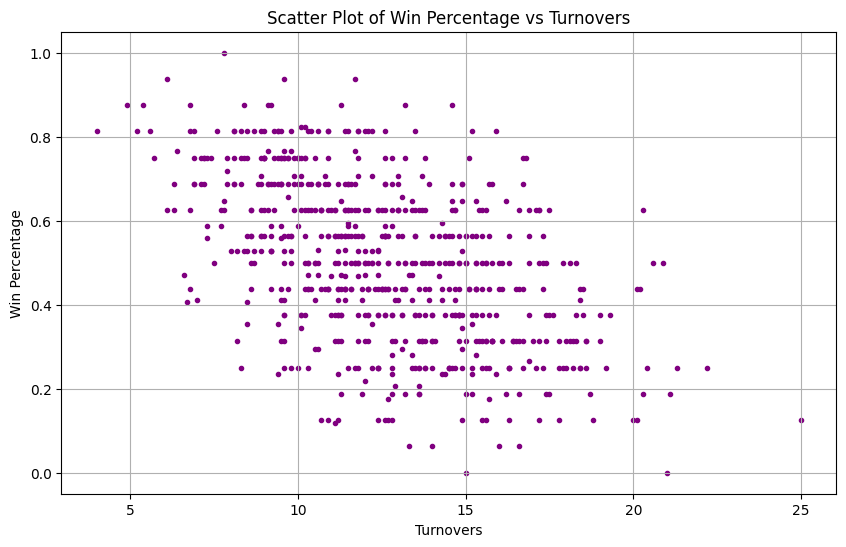

In [15]:
plt.clf()

plt.figure(figsize=(10, 6))  # Set the size of the plot

# Create a scatter plot
plt.scatter(x=df['turnover_pct'], y=df['win_loss_perc'], s=9, color= 'purple')

plt.xlabel('Turnovers')
plt.ylabel('Win Percentage')
plt.title('Scatter Plot of Win Percentage vs Turnovers')
plt.grid(True)
plt.show()


<Figure size 640x480 with 0 Axes>

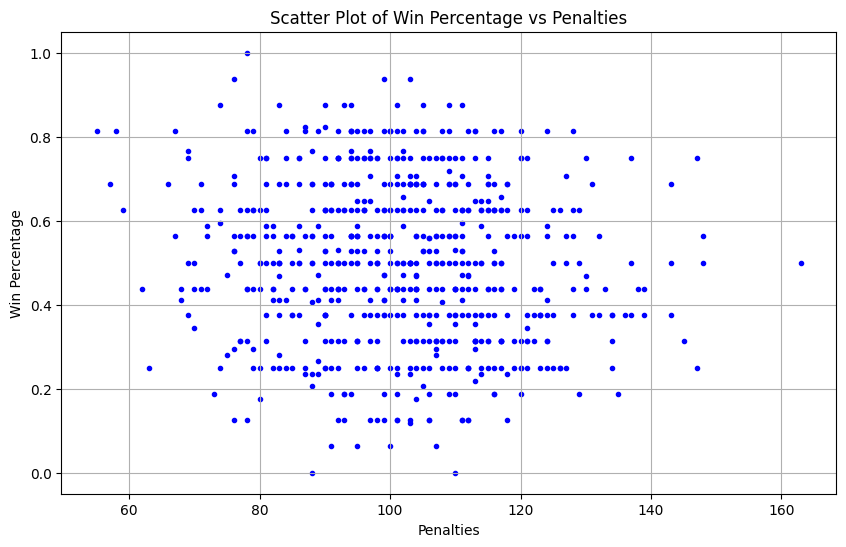

In [14]:
plt.clf()

plt.figure(figsize=(10, 6))  # Set the size of the plot

# Create a scatter plot
plt.scatter(x=df['penalties'], y=df['win_loss_perc'], s=9, color= 'blue')

plt.xlabel('Penalties')
plt.ylabel('Win Percentage')
plt.title('Scatter Plot of Win Percentage vs Penalties')
plt.grid(True)
plt.show()

<Figure size 640x480 with 0 Axes>

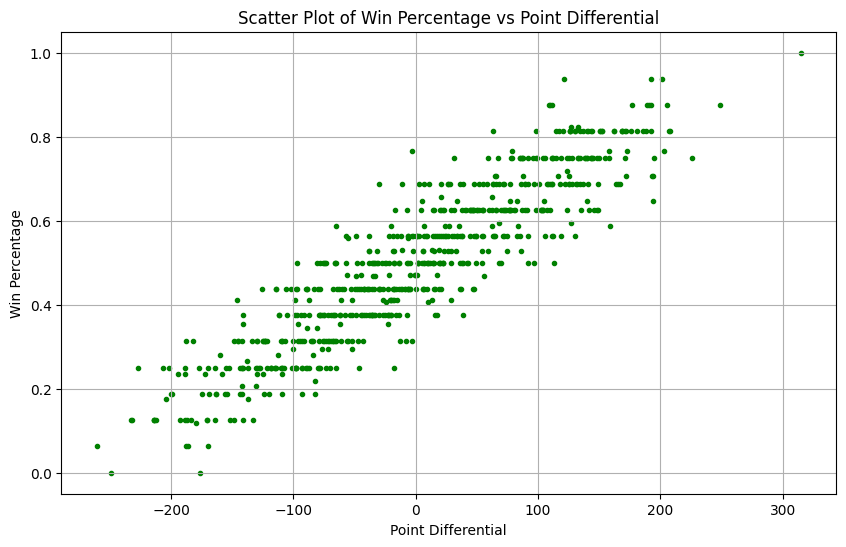

In [13]:
plt.clf()

plt.figure(figsize=(10, 6))  # Set the size of the plot

# Create a scatter plot
plt.scatter(x=df['points_diff'], y=df['win_loss_perc'], s=9, color= 'green')

plt.xlabel('Point Differential')
plt.ylabel('Win Percentage')
plt.title('Scatter Plot of Win Percentage vs Point Differential')
plt.grid(True)
plt.show()

In [16]:
import seaborn as sns

plt.clf()
sns.pairplot(df)
plt.show()

<Figure size 640x480 with 0 Axes>